# Saildrone Arctic IERP PII Mission

## Mission Details

### SD1022 Mission Components and Dates
- 07/14 Enter Bering Strait
- 07/20 Begin Chukchi Sea Survey 1
- 07/24 Begin Mooring Survey 1
- 07/25 C4
- 07/30 C1
- 08/09 C11
- 08/12 End Mooring Survey 1
- 08/16 End Chukchi Sea Survey 1
- 08/22 Begin Bottom Half Chukchi Sea Survey 2/Partial Mooring Survey 2
- 08/29 End Partial Mooring Survey 2
- 09/11 End Bottom Half Chukchi Sea Survey 2
- 09/13 Begin Kotzebue Pass
- 09/22 End Kotzebue Pass
- 09/24 Exit Bering Strait

### SD1023
- 07/15 Enter Bering Strait
- 07/21 Begin Mooring Survey 1
- 07/23 C11
- 08/01 C1
- 08/03 C4
- 08/04 End Mooring Survey 1
- 08/04 Begin Chukchi North Fill In
- 08/11 End Chukchi North Fill In
- 08/13 Begin Mooring Survey 2
- 08/13 C1
- 08/19 End Mooring Survey 2 Break for Wainwright
- 08/24 Begin Chukchi Sea Survey
- 08/31 Begin Mooring Survey 3
- 08/31 C1
- 09/08 C11
- 09/11 End Mooring Survey 3
- 09/15 End Chukchi Sea Survey
- 09/22 End Kotzebue Pass
- 09/24 Exit Bering Strait

## Overall Timing of Surveys

### Chukchi Sea Survey

- 07/20 to 08/16 (1022), 08/04 to 08/11 (1023 northern fill)
- 08/24 to 09/15 (1023, northern half), 08/22 to 09/11 (1022, southern half)

### Mooring Vistis

- C4: 07/25 (1022), 08/03 (1023)
- C1: 07/30 (1022), 08/01 (1023), 08/13 (1023), 08/31 (1023)
- C11:07/23 (1023), 08/09 (1022), 09/08 (1023)

### Mooring Surveys

- 07/21 to 08/04 (1023, complete)
- 07/24 to 08/13 (1022, complete)
- 08/13 to 08/19 (1023, partial), 08/24 to 08/29 (1022, partial)
- 08/31 to 09/11 (1023, complete)

## Library Imports

In [2]:
import pandas as pd
from glob import glob
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.mlab as mlab
from matplotlib.patches import Rectangle, Polygon
import matplotlib.ticker as mticker
from matplotlib import rcParams
from matplotlib.colors import LogNorm
import cartopy.crs as ccrs
import cartopy.feature as feature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from functools import reduce
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
#!pip install pysolar
#from pysolar.solar import get_altitude
import datetime
from progressBar import log_progress
import cmocean
from scipy import stats

def readExports(files):
    print('reading files...')
    hold = []
    for filename in files:
        df = pd.read_csv(filename, index_col=None, header=0)
        hold.append(df)
    df = pd.concat(hold, axis=0, ignore_index=True)
    df['Lon_M'][(df['Lon_M'] > 0)] = np.nan
    df['Lat_M'][(df['Lon_M'] > 0)] = np.nan
    df['Lon_M'][(df['Lat_M'] > 90)] = np.nan
    df['Lat_M'][(df['Lat_M'] > 90)] = np.nan
    print('setting datetimes...')
    df['datetime'] = pd.to_datetime(df["Date_M"].astype(str)+' '+df["Time_M"])
    df = df.rename(index=str, columns={"Lon_M": "lonC","Lat_M": "latC","PRC_NASC": "nasc","Layer":"layer","Depth_mean":"depthMean"})
    binCenters =np.arange(2.5, 100, 5)
    depth = []
    print('appending bin centers...')
    for layer in df.layer:
        depth.append(binCenters[int(layer)-1])
    df['depthBin'] = depth
    df['weightedSA'] =df.nasc*df.depthBin
    df = df.groupby(['Interval',"lonC", "latC","datetime"])[["nasc", "weightedSA"]].sum()
    df['mwd'] = df.weightedSA/df.nasc
    df = df.reset_index()
    return df

## Read in Data

Skip and read in pickle in sections below if nothing has changed

In [10]:
files1022 = glob('../../../data/EV/EVFiles/SD1022/exports/38kHzFiltered*5m*.csv')
files1023 = glob('../../../data/EV/EVFiles/SD1023/exports/38kHzFiltered*5m*.csv')
df1022 = readExports(files1022)
df1023 = readExports(files1023)

Let's take a look at the trackline, with color representing time

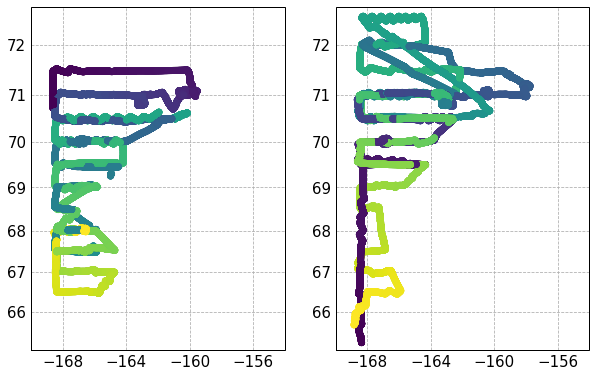

In [21]:
figure = plt.figure(figsize=(10,10))
ax1=plt.subplot(121,projection=ccrs.Mercator())
#ax1.add_feature(feature.LAND)
#ax1.coastlines(resolution='10m')
gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,linestyle='--',zorder=2)
gl.xlabels_top = False
gl.ylabels_right = False
gl.xlocator = mticker.FixedLocator([-170, -168, -164, -160, -156, -154])
gl.xlabel_style = {'size':15}
gl.ylabel_style = {'size':15}
a = ax1.scatter(df1022.lonC, df1022.latC,c = df1022['datetime'],cmap = 'viridis',transform=ccrs.Geodetic(),zorder=3)
ax1.set_extent([-154,-170,65,72.7])

ax2=plt.subplot(122,projection=ccrs.Mercator())
#ax2.add_feature(feature.LAND)
#ax2.coastlines(resolution='10m')
gl = ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,linestyle='--',zorder=2)
gl.xlabels_top = False
gl.ylabels_right = False
gl.xlocator = mticker.FixedLocator([-170, -168, -164, -160, -156, -154])
gl.xlabel_style = {'size':15}
gl.ylabel_style = {'size':15}
a = ax2.scatter(df1023.lonC, df1023.latC,c = df1023['datetime'],cmap = 'viridis',transform=ccrs.Geodetic(),zorder=3)
ax2.set_extent([-154,-170,65,72.7])

# First and Second Surveys

- 07/20 to 08/16 (1022), 08/04 to 08/11 (1023 northern fill)
- 08/24 to 09/15 (1023, northern half), 08/22 to 09/11 (1022, southern half)

## Combine into whole Tracks

In [23]:
etopo1name = 'processingFiles/etopo1_bedrock.asc'
topo_file = open(etopo1name, 'r')
ncols = int(topo_file.readline().split()[1])
nrows = int(topo_file.readline().split()[1])
xllcorner = float(topo_file.readline().split()[1])
yllcorner = float(topo_file.readline().split()[1])
cellsize = float(topo_file.readline().split()[1])
topo_file.close()
dres = 1
etopo = np.loadtxt(etopo1name, skiprows=5)
etopo[:nrows+1, :] = etopo[nrows+1::-1, :]
etopo = etopo[::dres, ::dres]

# Create longitude and latitude vectors for etopo
clons = np.arange(xllcorner, xllcorner+cellsize*ncols, cellsize)[::dres]
clats = np.arange(yllcorner, yllcorner+cellsize*nrows, cellsize)[::dres]

#etopo = etopo[(clats[:-1] >68)&(clats[:-1] <72)] # small
#clats = clats[(clats >68)&(clats <72)] # small
etopo = etopo[(clats[:-1] >65)&(clats[:-1] <74)] # big
clats = clats[(clats >65)&(clats <74)] # big

# Draw etopo1, first for land and then for the ocean, with different colormaps
llevels = np.arange(-500,2251,100) # check etopo.ravel().max()
rlons, rlats = (np.meshgrid(clons[:-1],clats))
rcParams['contour.negative_linestyle'] = 'solid'

def plotSurveySa(subTot,subAxis,df,extent,cogF=0, dfCOG=None,big=1):
    ax1=plt.subplot(1,subTot,subAxis,projection=ccrs.Mercator())
    #ax1.add_feature(feature.LAND)
    #ax1.coastlines(resolution='10m')
    gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,linestyle='--',zorder=1)
    gl.xlabels_top = False
    gl.ylabels_right = False
    if subAxis > 1:
        gl.ylabels_left = False
    gl.xlocator = mticker.FixedLocator([-170, -168, -164, -160, -156, -154])
    gl.ylocator = mticker.FixedLocator([64,66,68,70,72,74])
    gl.xlabel_style = {'size':15}
    gl.ylabel_style = {'size':15}
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    #rect =Rectangle((191.5,69.25), 6.5,2,edgecolor='k',linestyle='--',facecolor="None",transform=ccrs.Geodetic())
    if big==1:
        coords = [(-165.5,67.4),(-169,67.4),(-169,71.7),(-161.75,71.7),(-161.75,70.5),
                                (-163.75,70),(-163.75,69.5),(-165.5,68),(-165.5,67.4)]
    else:
        coords = [(-163.9,69.4),(-169,69.4),(-169,71.1),(-162,71.1),(-162.25,70.5),(-163.9,70.0),(-163.9,69.4)]
    polygon = Polygon(coords[::-1],True,facecolor='None', edgecolor='k',linestyle='--',transform=ccrs.Geodetic(),zorder=5)
    # Add the patch to the Axes
    ax1.add_patch(polygon)
    a = ax1.scatter(df.lonC, df.latC,c = np.log10(df.nasc),cmap = 'plasma',vmin=0, vmax=3,transform=ccrs.Geodetic(),zorder=4)
    ax1.set_extent(extent)
    
    olevels1 = [-1000,-100,-40] # change from NOAA int sugg.
    olevels3 = [0,10000]
    olevels4 = [0]

    lfill = ax1.contourf(rlons, rlats, etopo, olevels3, colors ='lightgrey',linewidths=1,transform=ccrs.PlateCarree(),zorder=6)#cmap=cm.ocean)
    cso1 = ax1.contour(rlons, rlats, etopo, olevels1, colors ='grey',linewidths=1,transform=ccrs.PlateCarree(),zorder=2)#cmap=cm.ocean)
    cso4 = ax1.contour(rlons, rlats, etopo, olevels4, colors ='k',linewidths=.5,transform=ccrs.PlateCarree(),zorder=7)#cmap=cm.ocean)
    
    try:
        ax1.set_title(pd.Timestamp(min(df.datetime.values)).strftime("%B %d") +' - '+ pd.Timestamp(max(df.datetime.values)).strftime("%B %d, %Y"), fontsize=15)
    except:
        ax1.set_title(str(subAxis))
    #plt.scatter(df.lonC, df.latC,c = np.log10(df.nasc),cmap = 'jet')
    if cogF == 1:
        df = dfCOG
        x,y = cog(np.array(df.latC),np.array(df.lonC), np.array(df.nasc))
        ax1.plot(x,y,'ok',transform=ccrs.Geodetic(),zorder=8)
        print('survey Center:', x,y)
        print('survey Mean sA:',np.mean(df.nasc))
        print('survey SE:', stats.sem(df.nasc, axis=None, ddof=0))
        ix,iy = spread(x,y,np.array(df.latC),np.array(df.lonC), np.array(df.nasc))
        ax1.plot([x+ix, x-ix],[y,y],'-k',transform=ccrs.Geodetic(),zorder=8)
        ax1.plot([x, x],[y+iy,y-iy],'-k',transform=ccrs.Geodetic(),zorder=8)
        print('survey spread:', ix,iy)
        return ax1
    
def cog(lat,lon,nasc):
    y = sum(lat*nasc)/sum(nasc)
    x = sum(lon*nasc)/sum(nasc)
    return x,y
def spread(cogx,cogy,lat, lon, nasc):
    ix = sum(((lon-cogx)**2)*nasc)/sum(nasc)
    iy = sum(((lat-cogy)**2)*nasc)/sum(nasc)
    return ix, iy

In [24]:
dfSurvey1 = df1022[(df1022.datetime > '07-20-2018') & (df1022.datetime < '08-21-2018') ]
dfSurvey1.name = 'First Complete Survey'

df1023CS2 = df1023[(df1023.datetime > '08-24-2018 15:00:00') & (df1023.datetime < '09-07-2018')]
df1022CS2 = df1022[(df1022.datetime > '08-25-2018') & (df1022.datetime < '09-11-2018 22:00:00') ]
dfSurvey2 = pd.concat([df1023CS2, df1022CS2])
dfSurvey2.name = 'Second Complete Survey'

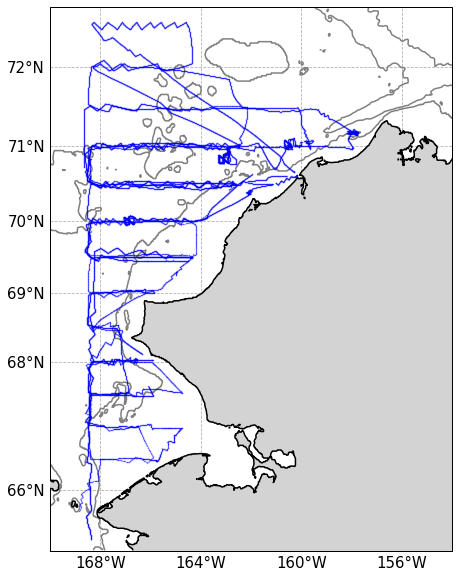

In [28]:
#Look at how much actually overlaps
figure = plt.figure(figsize=(10,10))
ax1=plt.subplot(111,projection=ccrs.Mercator())
gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,linestyle='--',zorder=1)
gl.xlabels_top = False
gl.ylabels_right = False
gl.xlocator = mticker.FixedLocator([-170, -168, -164, -160, -156, -154])
gl.ylocator = mticker.FixedLocator([64,66,68,69,70,71,72,74])
gl.xlabel_style = {'size':15}
gl.ylabel_style = {'size':15}
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER

olevels1 = [-1000,-100,-40] # change from NOAA int sugg.
olevels3 = [0,10000]
olevels4 = [0]
lfill = ax1.contourf(rlons, rlats, etopo, olevels3, colors ='lightgrey',transform=ccrs.PlateCarree(),zorder=4)#cmap=cm.ocean)
cso1 = ax1.contour(rlons, rlats, etopo, olevels1, colors ='grey',transform=ccrs.PlateCarree(),zorder=2)#cmap=cm.ocean)
#cso2 = ax1.contour(rlons, rlats, etopo, olevels2, colors ='lightgrey',transform=ccrs.PlateCarree(),zorder=3)#cmap=cm.ocean)
cso4 = ax1.contour(rlons, rlats, etopo, olevels4, colors ='k',transform=ccrs.PlateCarree(),zorder=5)#cmap=cm.ocean)
ax1.plot(df1022.lonC,df1022.latC, '.',color='blue',markersize=.7,transform=ccrs.Geodetic(),zorder=3,alpha=.2)
ax1.plot(df1023.lonC,df1023.latC, '.',color='blue',markersize=.7,transform=ccrs.Geodetic(),zorder=3,alpha=.2)
ax1.set_extent([-154,-170,65,72.7])


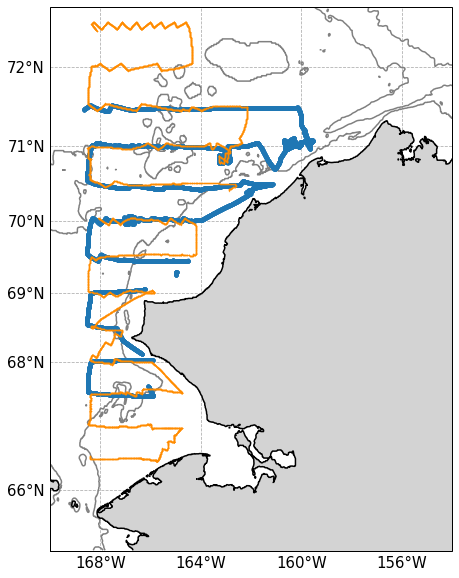

In [29]:
#Look at how much actually overlaps
figure = plt.figure(figsize=(10,10))
ax1=plt.subplot(111,projection=ccrs.Mercator())
gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,linestyle='--',zorder=1)
gl.xlabels_top = False
gl.ylabels_right = False
gl.xlocator = mticker.FixedLocator([-170, -168, -164, -160, -156, -154])
gl.ylocator = mticker.FixedLocator([64,66,68,69,70,71,72,74])
gl.xlabel_style = {'size':15}
gl.ylabel_style = {'size':15}
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
olevels1 = [-1000,-100,-40] # change from NOAA int sugg.
olevels3 = [0,10000]
olevels4 = [0]
lfill = ax1.contourf(rlons, rlats, etopo, olevels3, colors ='lightgrey',transform=ccrs.PlateCarree(),zorder=4)#cmap=cm.ocean)
cso1 = ax1.contour(rlons, rlats, etopo, olevels1, colors ='grey',transform=ccrs.PlateCarree(),zorder=2)#cmap=cm.ocean)
#cso2 = ax1.contour(rlons, rlats, etopo, olevels2, colors ='lightgrey',transform=ccrs.PlateCarree(),zorder=3)#cmap=cm.ocean)
cso4 = ax1.contour(rlons, rlats, etopo, olevels4, colors ='k',transform=ccrs.PlateCarree(),zorder=5)#cmap=cm.ocean)
ax1.plot(dfSurvey1.lonC,dfSurvey1.latC, '.',transform=ccrs.Geodetic(),zorder=3)
ax1.plot(dfSurvey2.lonC,dfSurvey2.latC, '.',color='darkorange',markersize=.7,transform=ccrs.Geodetic(),zorder=3)
ax1.set_extent([-154,-170,65,72.7])

In [30]:
def fastGrid(data):
    lats = np.arange(64.75, 72.5, 0.5)
    lons = np.arange(-170, -157.5, 0.5)
    nasc = []
    latC = []
    lonC = []
    for curlat in lats:
        for curlon in lons:
            curPoints = data[(data.latC > curlat) & (data.latC < curlat+.5) & 
                                  (data.lonC > curlon) & (data.lonC < curlon+.5)]
            if len(curPoints) > 0:
                nasc.append(np.nanmean(curPoints.nasc))
                latC.append(curlat+.25)
                lonC.append(curlon+.25)
    df = pd.DataFrame({'nasc':nasc, 'latC':latC,'lonC': lonC})
    df.name = data.name
    return df

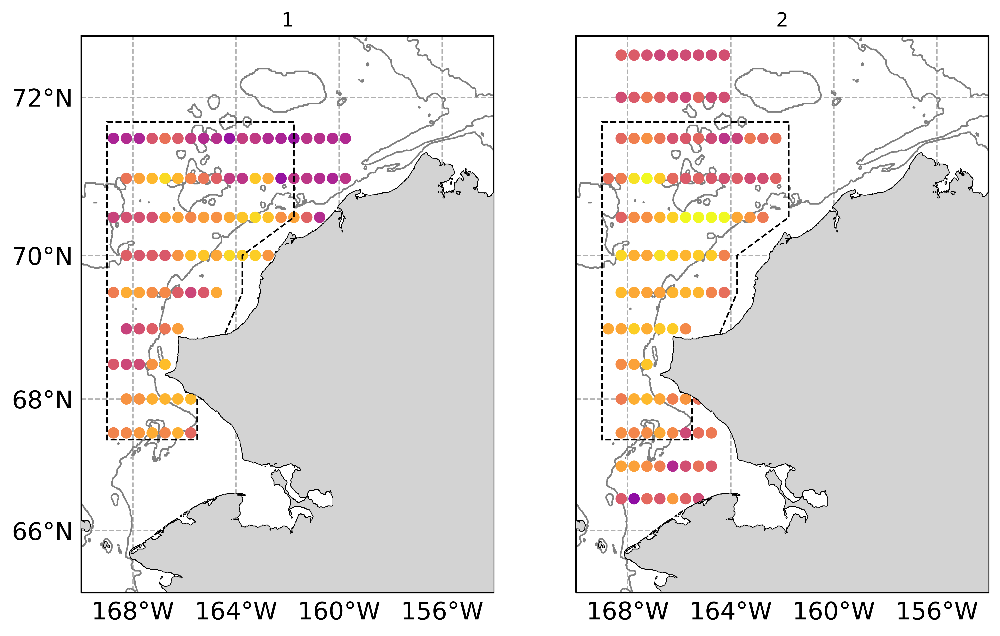

In [31]:
# Gridded Data
dfS1= fastGrid(dfSurvey1)
dfS2= fastGrid(dfSurvey2)
figure = plt.figure(figsize=(10,10),dpi=600)
plotSurveySa(2,1,dfS1,[-154,-170,65,72.7],0)
#s1Cells = list(zip(latC, lonC))
plotSurveySa(2,2,dfS2,[-154,-170,65,72.7],0)

#### Pickle the large suvey data

In [34]:
df1022.to_pickle('processingFiles/df1022.pkl')
df1023.to_pickle('processingFiles/df1023.pkl')
dfSurvey1.to_pickle('processingFiles/dfSurvey1.pkl')
dfSurvey2.to_pickle('processingFiles/dfSurvey2.pkl')
dfS1.to_pickle('processingFiles/dfS1Grid.pkl')
dfS2.to_pickle('processingFiles/dfS2Grid.pkl')

Let's plot up the N-S distribution of backscatter from both surveys

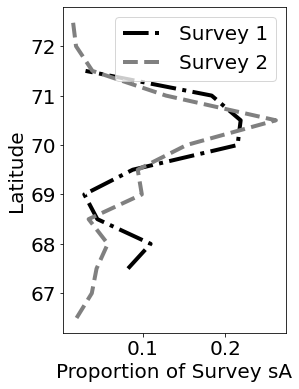

In [43]:
plt.figure(figsize=(4,6))
plt.plot(dfS1.groupby('latC').sum().nasc/dfS1.nasc.sum(),dfS1.groupby('latC').sum().index,'-.k',linewidth =4)
plt.plot(dfS2.groupby('latC').sum().nasc/dfS2.nasc.sum(),dfS2.groupby('latC').sum().index,'--', c='grey',linewidth =4)
plt.legend(['Survey 1','Survey 2'])
plt.ylabel('Latitude')
plt.xlabel('Proportion of Survey sA')
matplotlib.rcParams.update({'font.size': 20})

Let's look at just the overlapping grid locations and build a new set of points to use for the final analysis

There are  75  overlapping cells


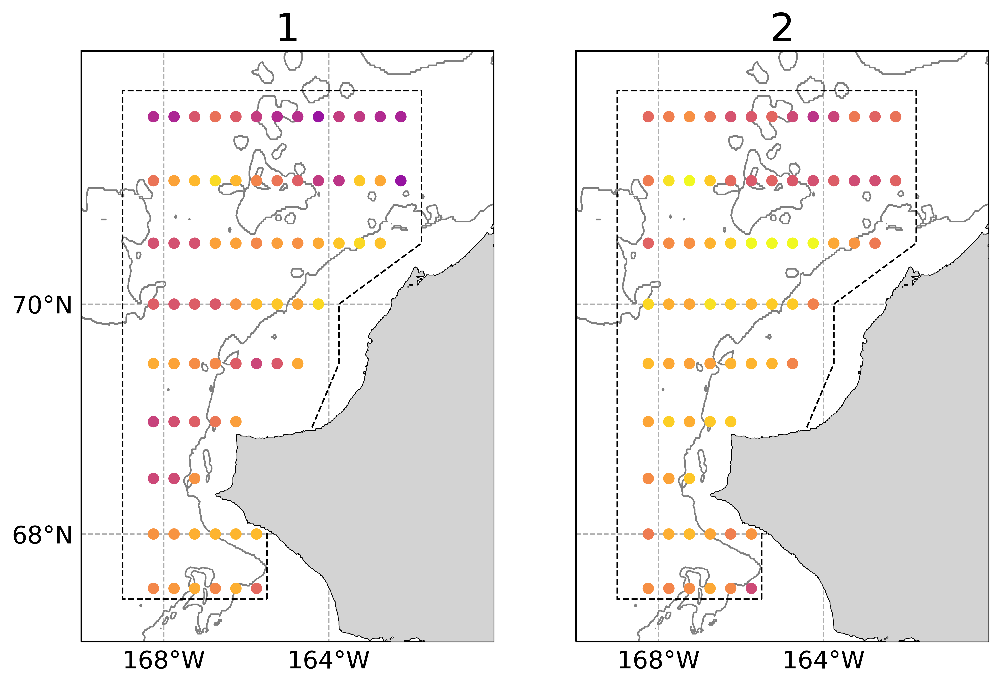

In [38]:
# Overlapping grid cells
dfOverlap = pd.merge(dfS1, dfS2, on=['latC','lonC'], how='inner')
dfOverlap.name = 'Overlapping Cells'
figure = plt.figure(figsize=(10,10),dpi=600)
plotSurveySa(2,1,dfOverlap[['nasc_x','latC', 'lonC']].rename(index=str, columns={"nasc_x": "nasc"}),[-160,-170,67,72],0)
plotSurveySa(2,2,dfOverlap[['nasc_y','latC', 'lonC']].rename(index=str, columns={"nasc_y": "nasc"}),[-160,-170,67,72],0)
print('There are ',len(dfOverlap),' overlapping cells')

Let's plot up the N-S distribution of backscatter from both surveys, this time only the overlapping gridded values

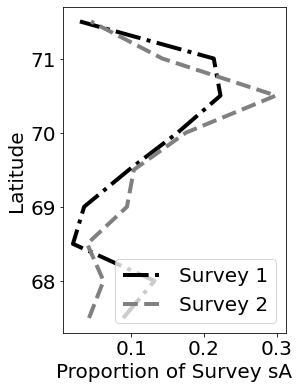

In [42]:
plt.figure(figsize=(4,6))
plt.plot(dfOverlap.groupby('latC').sum().nasc_x/dfOverlap.nasc_x.sum(),dfOverlap.groupby('latC').sum().index,'-.k',linewidth =4)
plt.plot(dfOverlap.groupby('latC').sum().nasc_y/dfOverlap.nasc_y.sum(),dfOverlap.groupby('latC').sum().index,'--', c='grey',linewidth =4)
plt.legend(['Survey 1','Survey 2'])
plt.ylabel('Latitude')
plt.xlabel('Proportion of Survey sA')
matplotlib.rcParams.update({'font.size': 20})

# Paper figures

Now that we have gridded data, we can plot the regular map with the gridded cog and spread

Text(0.5, 0, 's$_{A}$ (m$^{2}$ nmi$^{-2}$)')

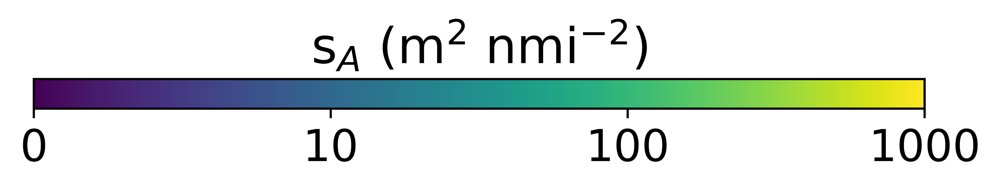

In [44]:
import matplotlib as mpl
fig = plt.figure(figsize=(5, 1),dpi=600)
ax1 = fig.add_axes([0.05, 0.80, 0.9, 0.15])
cmap = mpl.cm.viridis
norm = mpl.colors.Normalize(vmin=0, vmax=3)
cb1 = mpl.colorbar.ColorbarBase(ax1, cmap=cmap,
                                norm=norm,
                                orientation='horizontal',
                               ticks=[0,np.log10(10),np.log10(100),np.log10(1000)])
cb1.set_label('log$_{10}$(s$_{A}$)',fontsize=15)
cb1.ax.set_xticklabels(['0','10','100','1000'])
cb1.ax.tick_params(labelsize=16)
cb1.ax.get_xaxis().labelpad = -55
cb1.ax.set_xlabel('s$_{A}$ (m$^{2}$ nmi$^{-2}$)',size = 18)


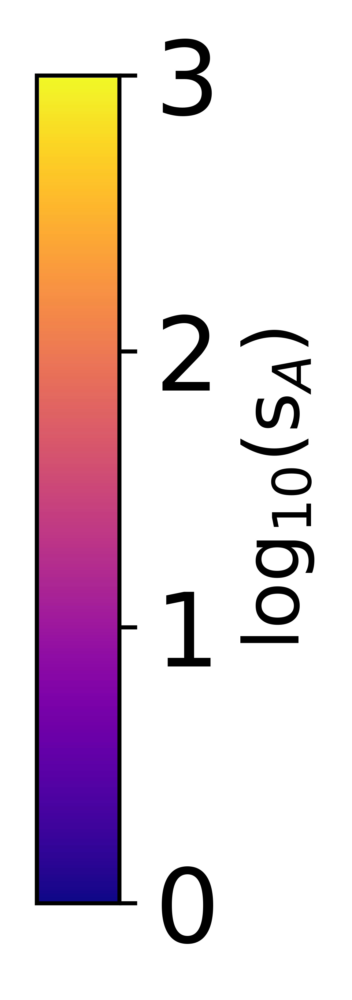

In [45]:
import matplotlib as mpl
fig = plt.figure(figsize=(.25, 15),dpi=1200)
ax1 = fig.add_axes([0.05, 0.80, 0.9, 0.15])
cmap = mpl.cm.plasma
norm = mpl.colors.Normalize(vmin=0, vmax=3)
cb1 = mpl.colorbar.ColorbarBase(ax1, cmap=cmap,
                                norm=norm,
                                orientation='vertical')
cb1.set_label('log$_{10}$(s$_{A}$)',fontsize=15)
#plt.savefig("G:/My Drive/Research/Arctic EIS II/Saildrone/manuscript/Final/figsUnfiltered/Submitted/svg/F3_cb.svg")

In [46]:
figure = plt.figure(figsize=(10,10),dpi=1200)
plotSurveySa(2,1,dfSurvey1,[-154,-170,65,73],cogF=1,dfCOG=dfOverlap[['nasc_x','latC', 'lonC']].rename(index=str, columns={"nasc_x": "nasc"}),big=1)
plotSurveySa(2,2,dfSurvey2,[-154,-170,65,73],cogF=1,dfCOG=dfOverlap[['nasc_y','latC', 'lonC']].rename(index=str, columns={"nasc_y": "nasc"}),big=1)
plt.subplots_adjust(wspace=.05,hspace = .3)
#plt.savefig("G:/My Drive/Research/Arctic EIS II/Saildrone/manuscript/Final/figsUnfiltered/Submitted/svg/F3.svg")

survey Center: -165.79579133323062 69.77090498024607
survey Mean sA: 164.5382072558018
survey SE: 17.443781020512784
survey spread: 2.6143592335302657 1.4654408068099238
survey Center: -166.28235224124415 69.92756657601196
survey Mean sA: 278.30948288922934
survey SE: 32.946677647684645
survey spread: 1.8685855645028167 1.0243479685832486


In [47]:
import geopy.distance as dis
# Coordinates are from output above
coords_1 = (69.77090498024607,-165.79579133323062 )
coords_2 = (69.92756657601196, -166.28235224124415)
print('Total Change: ',dis.distance(coords_1, coords_2).km)

coords_1 = (69.77090498024607,-166.28235224124415)
coords_2 = (69.92756657601196, -166.28235224124415)
#?dis.distance
print('Change in Lat: ',dis.distance(coords_1, coords_2).km)

coords_1 = (69.77090498024607,-165.79579133323062)
coords_2 = (69.77090498024607, -166.28235224124415)
print('Change in Lon: ',dis.distance(coords_1, coords_2).km)

Total Change:  25.606006018506466
Change in Lat:  17.477185259211428
Change in Lon:  18.783830994428


# Mooring Line mini Surveys
- 07/21 to 08/04 (1023, complete)
- 07/24 to 08/13 (1022, complete)
- 08/13 to 08/19 (1023, partial), 08/24 to 08/29 (1022, partial)
- 08/31 to 09/11 (1023, complete)

In [48]:
dfMLS1 = df1023[(df1023.datetime > '07-20-2018 20:00:00') & (df1023.datetime < '08-04-2018 00:00:00')]
dfMLS1.name = 'MLS-1'
dfMLS2 = df1022[(df1022.datetime > '07-23-2018 20:00:00') & (df1022.datetime < '08-13-2018 00:00:00')]
dfMLS2.name = 'MLS-2'
dfMLS3 = pd.concat([df1023[(df1023.datetime > '08-13-2018 15:00:00') & (df1023.datetime < '08-16-2018 20:00:00')], df1022[(df1022.datetime > '08-22-2018 00:00:00') & (df1022.datetime < '08-29-2018 00:00:00')]])
dfMLS3.name = 'MLS-3'
dfMLS4 = df1023[(df1023.datetime > '08-30-2018 20:00:00') & (df1023.datetime < '09-11-2018 17:00:00')]
dfMLS4.name = 'MLS-4'
dfMLS1Grid= fastGrid(dfMLS1)
dfMLS2Grid= fastGrid(dfMLS2)
dfMLS3Grid= fastGrid(dfMLS3)
dfMLS4Grid= fastGrid(dfMLS4)
dfs = [dfMLS1Grid, dfMLS2Grid, dfMLS3Grid, dfMLS4Grid]
dfOverlapMLS = reduce(lambda left,right: pd.merge(left,right,on=['latC','lonC']), dfs)
dfOverlapMLS.columns = ['nascMLS1', 'latC', 'lonC', 'nascMLS2','nascMLS3','nascMLS4']

In [49]:
figure = plt.figure(figsize=(20,20),dpi=1200)
plotSurveySa(4,1,dfMLS1,[-158,-170,68,72],cogF=1,dfCOG=dfOverlapMLS[['nascMLS1','latC', 'lonC']].rename(index=str, columns={"nascMLS1": "nasc"}),big=0)
plotSurveySa(4,2,dfMLS2,[-158,-170,68,72],cogF=1,dfCOG=dfOverlapMLS[['nascMLS2','latC', 'lonC']].rename(index=str, columns={"nascMLS2": "nasc"}),big=0)
plotSurveySa(4,3,dfMLS3,[-158,-170,68,72],cogF=1,dfCOG=dfOverlapMLS[['nascMLS3','latC', 'lonC']].rename(index=str, columns={"nascMLS3": "nasc"}),big=0)
plotSurveySa(4,4,dfMLS4,[-158,-170,68,72],cogF=1,dfCOG=dfOverlapMLS[['nascMLS4','latC', 'lonC']].rename(index=str, columns={"nascMLS4": "nasc"}),big=0)
#plotSurveySa(2,2,data2,[-154,-170,65,72.7],0)
plt.subplots_adjust(wspace=.05,hspace = .3)
plt.savefig("G:/My Drive/Research/Arctic EIS II/Saildrone/manuscript/Final/figsUnfiltered/Submitted/svg/F5.svg")

survey Center: -165.56711667807548 70.37268591263998
survey Mean sA: 252.1153764032493
survey SE: 32.753539010505435
survey spread: 1.8702675482599858 0.2109681739382847
survey Center: -165.35435221554883 70.39105411372952
survey Mean sA: 205.95727412433652
survey SE: 25.803561709292573
survey spread: 2.715054772195117 0.2670104575851932
survey Center: -165.80371594544658 70.24512503016498
survey Mean sA: 265.3415726262529
survey SE: 33.63105987787562
survey spread: 2.8277236200312554 0.24721862399770628
survey Center: -166.0822695893135 70.1988040618894
survey Mean sA: 428.55250889331165
survey SE: 57.909864845509
survey spread: 1.6767317863085718 0.28028260443336495


In [50]:
import geopy.distance as dis
# Coordinates are from output above
coords_1 = (70.37268591263998, -165.56711667807548)
coords_2 = (70.1988040618894, -166.0822695893135)
print('Total Change: ',dis.distance(coords_1, coords_2).km)

coords_1 = (70.37268591263998,-166.0822695893135)
coords_2 = (70.1988040618894, -166.0822695893135)
print('Change in Lat: ',dis.distance(coords_1, coords_2).km)

coords_1 = (70.37268591263998, -165.56711667807548)
coords_2 = (70.37268591263998, -166.0822695893135)
print('Change in Lon: ',dis.distance(coords_1, coords_2).km)

Total Change:  27.4366769364221
Change in Lat:  19.399235716050956
Change in Lon:  19.320145157398994


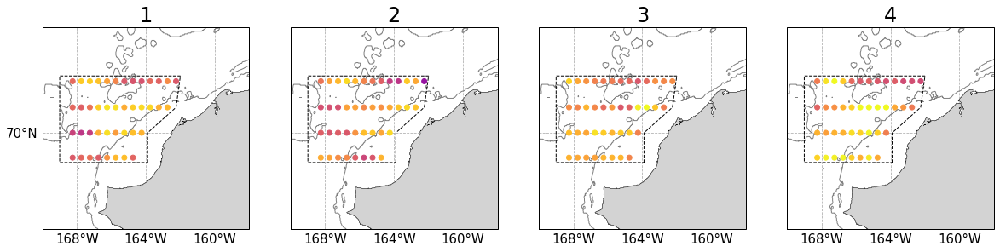

In [51]:
figure = plt.figure(figsize=(20,20))
plotSurveySa(4,1,dfOverlapMLS[['nascMLS1','latC', 'lonC']].rename(index=str, columns={"nascMLS1": "nasc"}),[-158,-170,68,72],0,big=0)
plotSurveySa(4,2,dfOverlapMLS[['nascMLS2','latC', 'lonC']].rename(index=str, columns={"nascMLS2": "nasc"}),[-158,-170,68,72],0,big=0)
plotSurveySa(4,3,dfOverlapMLS[['nascMLS3','latC', 'lonC']].rename(index=str, columns={"nascMLS3": "nasc"}),[-158,-170,68,72],0,big=0)
plotSurveySa(4,4,dfOverlapMLS[['nascMLS4','latC', 'lonC']].rename(index=str, columns={"nascMLS4": "nasc"}),[-158,-170,68,72],0,big=0)

## Let's pickle everything so we can say goodbye to this notebook

In [52]:
dfMLS1Grid.to_pickle('processingFiles//dfMLS1Grid.pkl')
dfMLS2Grid.to_pickle('processingFiles/dfMLS2Grid.pkl')
dfMLS3Grid.to_pickle('processingFiles/dfMLS3Grid.pkl')
dfMLS4Grid.to_pickle('processingFiles/dfMLS4Grid.pkl')
dfMLS1.to_pickle('processingFiles/dfMLS1.pkl')
dfMLS2.to_pickle('processingFiles/dfMLS2.pkl')
dfMLS3.to_pickle('processingFiles/dfMLS3.pkl')
dfMLS4.to_pickle('processingFiles/dfMLS4.pkl')

# Depth distribution
This is with the 1m data

In [3]:
files1022 = glob('../../../data/EV/EVFiles/SD1022/exports/38kHzFiltered*1m*.csv')
files1023 = glob('../../../data/EV/EVFiles/SD1023/exports/38kHzFiltered*1m*.csv')

def readExports(files):
    print('reading files...')
    hold = []
    for filename in files:
        df = pd.read_csv(filename, index_col=None, header=0)
        hold.append(df)
    df = pd.concat(hold, axis=0, ignore_index=True)
    df['datetime'] = pd.to_datetime(df["Date_M"].astype(str)+' '+df["Time_M"])
    return df

df1022 = readExports(files1022)
df1023 = readExports(files1023)    

reading files...
reading files...


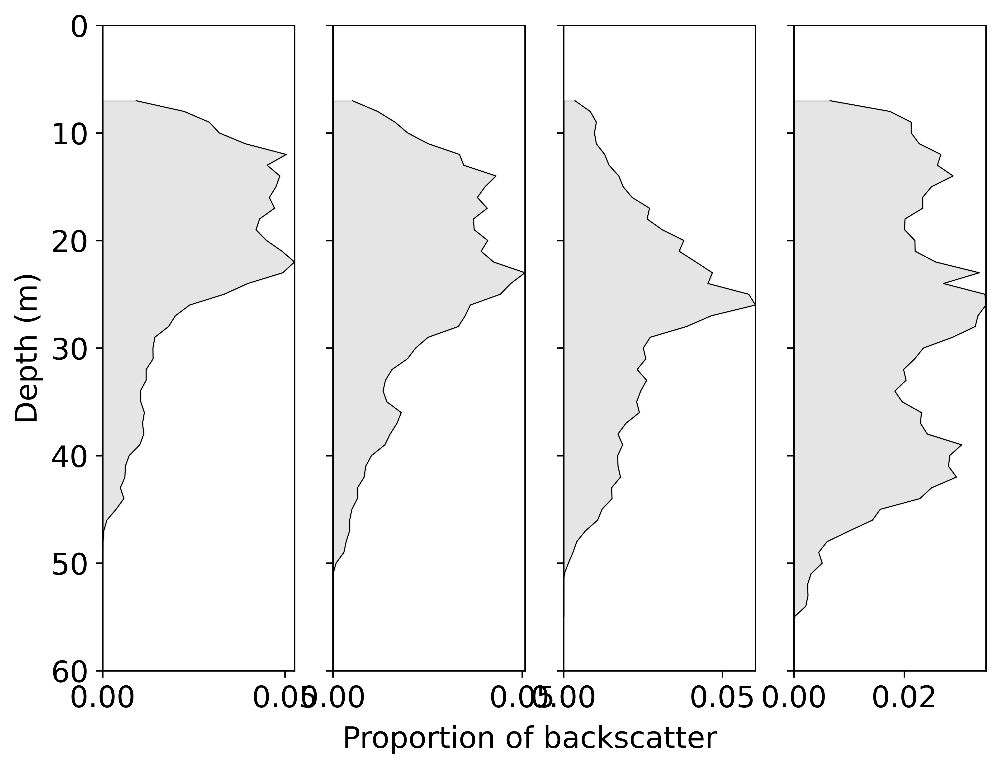

In [5]:
dfMLS1 = df1023[(df1023.datetime > '07-20-2018 20:00:00') & (df1023.datetime < '08-04-2018 00:00:00')]
dfMLS1.name = 'MLS-1'
dfMLS2 = df1022[(df1022.datetime > '07-23-2018 20:00:00') & (df1022.datetime < '08-13-2018 00:00:00')]
dfMLS2.name = 'MLS-2'
dfMLS3 = pd.concat([df1023[(df1023.datetime > '08-13-2018 15:00:00') & (df1023.datetime < '08-16-2018 20:00:00')], df1022[(df1022.datetime > '08-22-2018 00:00:00') & (df1022.datetime < '08-29-2018 00:00:00')]])
dfMLS3.name = 'MLS-3'
dfMLS4 = df1023[(df1023.datetime > '08-30-2018 20:00:00') & (df1023.datetime < '09-11-2018 17:00:00')]
dfMLS4.name = 'MLS-4'

rcParams.update({'font.size': 15})
fig= plt.figure(figsize=(8,6), dpi=600)
ct = 1
for df in [dfMLS1, dfMLS2, dfMLS3, dfMLS4]:

    depthBins = df.groupby('Layer').sum().index
    depthSA = df.groupby('Layer').sum()['PRC_NASC'].values
    plt.subplot(1,4,ct)
    plt.plot(depthSA/sum(depthSA),depthBins, color='k', linewidth=.5)
    plt.fill_betweenx(depthBins,0,depthSA/sum(depthSA), color = 'grey', alpha = 0.2)
    plt.axis([0, max(depthSA/sum(depthSA)),0,60])
    #plt.gca().set_xticks([])
    plt.gca().invert_yaxis()
    if ct ==1:
        plt.ylabel('Depth (m)')
        #plt.gca().spines['right'].set_visible(False)
        #plt.gca().spines['top'].set_visible(False)
        #plt.gca().spines['bottom'].set_visible(False)
    else:
        plt.vlines(0,min(depthBins), max(depthBins), color='k', linewidth=1)
        plt.gca().set_yticklabels([])
        #plt.gca().set_yticks([])
        #plt.gca().axis('off')
    ct+=1
fig.text(0.5, 0.035, 'Proportion of backscatter', ha='center');

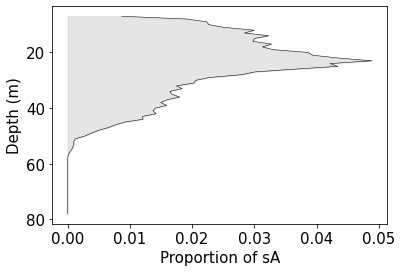

In [6]:
df = pd.concat([df1022,df1023])
depthBins = df.groupby('Layer').sum().index
depthSA = df.groupby('Layer').sum()['PRC_NASC'].values
plt.plot(depthSA/sum(depthSA),depthBins, color='k', linewidth=.5)
plt.fill_betweenx(depthBins,0,depthSA/sum(depthSA), color = 'grey', alpha = 0.2)
plt.xlabel('Proportion of sA')
plt.ylabel('Depth (m)')
#plt.axis([0, max(depthSA/sum(depthSA)),0,50])
#plt.gca().set_xticks([])
plt.gca().invert_yaxis()

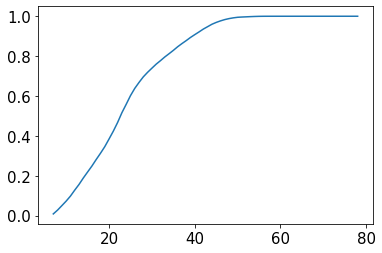

In [10]:
plt.plot(depthBins,np.cumsum(depthSA)/sum(depthSA))

In [11]:
depthBins

Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40,
            41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
            58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74,
            75, 76, 77, 78],
           dtype='int64', name='Layer')

In [12]:
sum(depthSA[(depthBins>=10) & ((depthBins<=40))])/sum(depthSA)

0.8574769181376888